# Исследование рынка заведений общественного питания Москвы

Инвесторы из фонда «Shut Up and Take My Money» планируют открыть заведение общественного питания в Москве. Еще не известно, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

Необходимо подготовить рекомендации для инвесторов по выбору подходящего места.

# Введение

**Проект направлен** на анализ рынка Москвы, поиск интересных особенностей и презентацию полученных результатов.

**Цель исследования**:

* Исследовать данные и узнать: сколько всего кофеен в датасете, в каких районах их больше всего, каковы особенности их расположения, есть ли круглосуточные кофейни, какие у кофеен рейтинги, как они распределяются по районам, на какую стоимость чашки капучино стоит ориентироваться при открытии и почему;
* Построить визуализацию, подкрепляющую выводы;
* Подготовить презентацию. 

**Описание исходных данных:**

Нам доступен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес (справочный характер) на лето 2022 года.

Структура moscow_places.csv:
* *name* — название заведения;
* *address* — адрес заведения;
* *category* — категория заведения, например «кафе», «пиццерия» или «кофейня»;
* *hours* — информация о днях и часах работы;
* *lat* — широта географической точки, в которой находится заведение;
* *lng* — долгота географической точки, в которой находится заведение;
* *rating* — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
* *price* — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
* *avg_bill* — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
   * «Средний счёт: 1000–1500 ₽»;
   * «Цена чашки капучино: 130–220 ₽»;
   * «Цена бокала пива: 400–600 ₽».
и так далее;
* *middle_avg_bill* — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
    * Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
    * Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
    * Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
* *middle_coffee_cup* — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
    * Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
    * Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
    * Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
* *chain* — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):
    * 0 — заведение не является сетевым
    * 1 — заведение является сетевым
* *district* — административный район, в котором находится заведение, например Центральный административный округ;
* *seats* — количество посадочных мест.

Границы районов Москвы, которые встречаются в датасете, хранятся в файле admin_level_geomap.geojson.

**Исследование пройдет в 5 основных этапов:**

 * Обзор исходных данных;
 * Предобработка исходных данных;
 * Исследование данных;
 * Детализация исследования: открытие кофейни;
 * Подготовка презентации. 

<a id="Содержание"></a>
# Содержание

1. [Обзор исходных данных](#Обзор-исходных-данных)
2. [Предобработка данных](#Предобработка-данных)
3. [Исследование данных](#Исследование-данных)
    * [Исследование количества объектов общественного питания по категориям](#Объекты-по-категориям)
    * [Исследование количества посадочных мест в заведениях по категориям](#Места-по-категориям)
    * [Соотношение сетевых и несетевых заведений в датасете](#Соотношение-сетей)
    * [Топ-15 популярных сетей в Москве](#Топ-15-сетей)
    * [Общее количество заведений и количество заведений каждой категории по районам](#Заведения-по-районам)
    * [Распределение средних рейтингов по категориям заведений](#Заведения-по-рейтингу)
    * [Фоновая картограмма со средним рейтингом заведений каждого района.](#Картограмма-районов)
    * [Все заведения датасета на карте](#Заведения-на-карте)
    * [Топ-15 улиц по количеству заведений](#Топ-15-улиц)
    * [Расчеты по средним чекам заведений](#Расчеты-по-средним-чекам)
4. [Детализация исследования: открытие кофейни](#Детализация-исследования)
    * [Анализ количества кофеен по районам](#Анализ-кофеен-по-районам)
    * [Поиск круглосуточных кофеен](#Круглосуточные-кофейни)
    * [Распределение рейтингов кофеен по районам](#Рейтинг-кофеен-по-районам)
    * [Анализ стоимости чашки капучино](#Стоимость-капучино)
    * [Рекомендация](#Рекомендация)
5. [Общий вывод](#Общий-вывод)
6. [Подготовка презентации](#Подготовка-презентации)

<a id='Обзор-исходных-данных'></a>
## Обзор исходных данных

In [1]:
%%capture
!pip install missingno

#импортируем необходимые для проекта библиотеки
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import missingno as msno
import plotly.express as px
import json
from folium import Marker, Map, Choropleth
from folium.plugins import MarkerCluster
from folium import GeoJson

#для выделения улиц в отдельный столбец
import re

#отключим неинформативные предупреждения для выполняемых блоков тетрадки
import warnings
warnings.filterwarnings("ignore")

In [2]:
#объявим переменную с дф датасета 
places = pd.read_csv('/datasets/moscow_places.csv')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


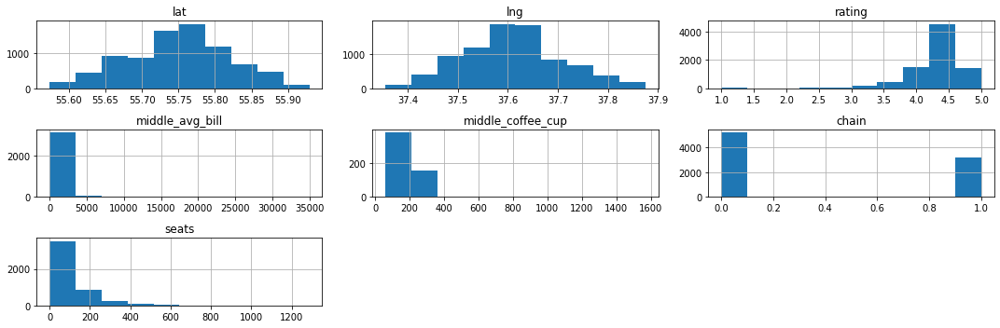

In [3]:
#выведем информацию по дф 
display(places.head())
places.info()
places.hist(figsize=(15, 5))
plt.tight_layout()
plt.show()

Выявлены аномалии в столбцах со справочными данными: *middle_avg_bill* - нулевые значения, *seats* - нулевые значения, *middle_coffee_cup* - присутствуют неадекватно низкие значения. 

Выявлено большое количество пропусков в столбцах *hours*, *price*, *avg_bill*, *middle_avg_bill*, *middle_coffee_cup*, *seats*.

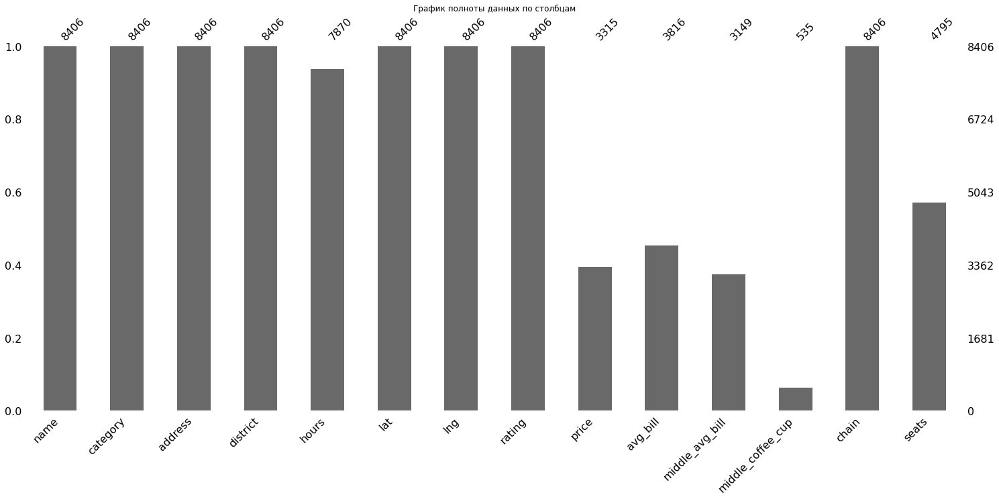

In [4]:
#отобразим пропуски графиком для наглядности
msno.bar(places)
plt.title('График полноты данных по столбцам')
plt.show()

Также посмотрим на вариации категориальных значений в наших данных:

In [5]:
places['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [6]:
places['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [7]:
places['price'].unique()

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

Ничего необычного нет.

Убедимся, что указанные в датасете адреса относятся к Москве:

In [8]:
places[~places['address'].str.contains("Москва", na=False)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats


Город во всех адресах - Москва. 

**Вывод:**

Мы провели первичный обзор данных, выявлены аномалии в столбцах со справочными данными: middle_avg_bill - нулевые значения, seats - нулевые значения, middle_coffee_cup - неадекватно низкие значения, есть большое количество пропусков в столбцах hours, price, avg_bill, middle_avg_bill, middle_coffee_cup, seats. 

[Вернуться к содержанию](#Содержание)

<a id="Предобработка-данных"></a>
## Предобработка данных

Для удобства приведем значения столбцов name, hours, avg_bill к нижнему регистру на случай разного написания (проверенные столбцы не меняем):

In [9]:
places[['name', 'hours', 'avg_bill']] = places[['name', 'hours', 'avg_bill']]\
.apply(lambda x: x.str.lower() if x.dtype == "object" else x)
places.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,средний счёт:400–600 ₽,500.0,NaN,1,148.0


Определим аномальные нулевые значения в столбцах middle_avg_bill и middle_coffee_cup как пропуски:

In [10]:
places[['middle_avg_bill', 'middle_coffee_cup']].replace(0, np.nan, inplace=True)

Аномалии в столбце middle_coffee_cup обрабатывать не будем, так как неизвестна их природа.

Ранее мы обнаружили большое количество пропусков в столбцах hours, price, avg_bill, middle_avg_bill, middle_coffee_cup, seats. Удаление большого количества строк уменьшит значимость данных, заполнить пропуски адекватными значениями так же не представляется возможным, в связи с чем просто проставим значения-индикаторы:

In [11]:
# nd для object столбцов 
for i in ['hours', 'price', 'avg_bill']:
    places[i] = places[i].fillna('nd')
    
# -1 для числовых столбцов
for i in ['middle_avg_bill', 'middle_coffee_cup', 'seats']:
    places[i] = places[i].fillna(-1)

places.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              8406 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              8406 non-null   object 
 9   avg_bill           8406 non-null   object 
 10  middle_avg_bill    8406 non-null   float64
 11  middle_coffee_cup  8406 non-null   float64
 12  chain              8406 non-null   int64  
 13  seats              8406 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Проверим данные на дубликаты:

In [12]:
print(f'Количество дубликатов:', places.duplicated().sum())
print(f'Доля дубликатов в данных, %:', round(places.duplicated().sum() / places['name'].count() * 100, 3))
places = places.drop_duplicates() 
print(f'Количество после обработки:', places.duplicated().sum())

Количество дубликатов: 0
Доля дубликатов в данных, %: 0.0
Количество после обработки: 0


Явных дубликатов не выявлено, неявных дубликатов мы не нашли при проверке значений в обзоре исходных данных.

Также проверим данные на наличие неполных дубликатов:

In [13]:
#используем ключевую комбинацию столбцов, по которой могут быть дубликаты
places[places.duplicated(subset=['name', 'address'], keep=False)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1430,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.806307,37.497566,4.2,nd,nd,-1.0,-1.0,0,188.0
1511,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,nd,nd,-1.0,-1.0,1,188.0
2211,раковарня клешни и хвосты,ресторан,"Москва, проспект Мира, 118",Северо-Восточный административный округ,"ежедневно, 12:00–00:00",55.810553,37.638161,4.4,nd,nd,-1.0,-1.0,0,150.0
2420,раковарня клешни и хвосты,"бар,паб","Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,nd,nd,-1.0,-1.0,1,150.0
3091,хлеб да выпечка,булочная,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738886,37.411648,4.1,nd,nd,-1.0,-1.0,1,276.0
3109,хлеб да выпечка,кафе,"Москва, Ярцевская улица, 19",Западный административный округ,nd,55.738449,37.410937,4.1,nd,nd,-1.0,-1.0,0,276.0


Выявлено 3 дубликата заведений "more poke", "раковарня клешни и хвосты" и "хлеб да выпечка". Оставим из них те строки, которые содержат больше данных о заведении:

In [14]:
places = places.drop([1430, 2211, 3109]).reset_index(drop=True)

In [15]:
print('Количество оставшихся дублей:', places[places.duplicated(subset=['name', 'address'], keep=False)]['name'].count())

Количество оставшихся дублей: 0


Создадим столбец с названиями улиц из столбца с адресом:

In [16]:
places['street'] = places['address'].str.split(', ').str[1]

Создадим столбец с обозначением, что заведение работает ежедневно и круглосуточно (24/7):

In [17]:
places['is_24_7'] = np.where((places['hours'].str.contains('круглосуточно') & places['hours'].str.contains('ежедневно')),\
                             True, False)
#проверим
display(places.head(3))
places[places['is_24_7']==True].sample(3)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,nd,nd,-1.0,-1.0,0,-1.0,улица Дыбенко,False
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,средний счёт:1500–1600 ₽,1550.0,-1.0,0,4.0,улица Дыбенко,False
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,средний счёт:от 1000 ₽,1000.0,-1.0,0,45.0,Клязьминская улица,False


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
7759,рослеспром,кафе,"Москва, Варшавское шоссе, 145, корп. 8",Южный административный округ,"ежедневно, круглосуточно",55.578627,37.602678,4.0,nd,nd,-1.0,-1.0,0,20.0,Варшавское шоссе,True
6609,файзи,кафе,"Москва, улица Академика Волгина, 25к1",Юго-Западный административный округ,"ежедневно, круглосуточно",55.644941,37.509515,4.2,средние,средний счёт:300–700 ₽,500.0,-1.0,0,-1.0,улица Академика Волгина,True
5081,караван,кафе,"Москва, Гжельский переулок, 19",Центральный административный округ,"ежедневно, круглосуточно",55.747663,37.680266,4.2,средние,средний счёт:400–600 ₽,500.0,-1.0,1,-1.0,Гжельский переулок,True


Изменения произведены успешно.

**Вывод:**

Мы провели предобработку данных:

* Все значения формата object приведены к нижнему регистру (за исключением столбца *district*);
* Аномальные нулевые значения в столбцах middle_avg_bill и middle_coffee_cup как пропуски
* Пропуски заполнены значением-индикатором "nd" в object столбцах, числовые - "-1";
* Удалены неполные дубликаты; 
* Создан столбец с названиями улиц *street*; 
* Создан столбец с обозначением, что заведение работает ежедневно и круглосуточно, *is_24_7*. 

[Вернуться к содержанию](#Содержание)

<a id='Исследование-данных'></a>
## Исследование данных

<a id='Объекты-по-категориям'></a>
Исследуем количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее.

In [18]:
places_category = places.groupby('category')['name'].count().reset_index().sort_values(by='name', ascending=False)
places_category.columns = ['category', 'count']
places_category['part'] = round((places_category['count'] / places_category['count'].sum()), 3)
places_category

,category,count,part
3,кафе,2377,0.283
6,ресторан,2041,0.243
4,кофейня,1413,0.168
0,"бар,паб",765,0.091
5,пиццерия,633,0.075
2,быстрое питание,603,0.072
7,столовая,315,0.037
1,булочная,256,0.030


Представим наглядно: 

In [19]:
fig = px.bar(places_category, x='category', y='count', text='count', hover_data={'part': ':.2%'},
             title='Количество объектов общественного питания по категориям')
fig.update_layout(xaxis_title='Категории заведений', yaxis_title='Количество заведений')
fig.show()

Видим, что наибольшее количество объектов приходится на кафе (2377) и рестораны (2041), за ними следуют кофейни (1413). В среднюю категорию по количеству входят бары/пабы (765), пиццерии (633) и заведения быстрого питания (603), отстающими являются столовые (315) и булочные (256).  

<a id='Места-по-категориям'></a>
Исследуем количество посадочных мест в заведениях по категориям: рестораны, кофейни, пиццерии, бары и так далее:

In [20]:
seats = places[places['seats'] != -1].groupby('category').agg(sum=('seats', 'sum'), median=('seats', 'median'))\
.sort_values(by='median', ascending=False).reset_index()

seats

,category,sum,median
0,ресторан,154531.0,86.0
1,"бар,паб",58281.0,82.5
2,кофейня,83511.0,80.0
3,столовая,16359.0,75.5
4,быстрое питание,34513.0,65.0
5,кафе,118494.0,60.0
6,пиццерия,40350.0,55.0
7,булочная,13229.0,50.0


In [21]:
#строим график для наглядности
fig = px.bar(seats, x='category', y='median', text='median', hover_data=['sum'],
             title='Количество посадочных мест в заведениях по категориям')
fig.update_layout(xaxis_title='Категории заведений', yaxis_title='Медиана количества посадочных мест')
fig.show()

Больше всего посадочных мест как в абсолютном выражении, так и по медиане - в категории ресторанов, напротив, менее всего мест в категории булочных.

<a id='Соотношение-сетей'></a>
Рассмотрим соотношение сетевых и несетевых заведений в датасете:

In [22]:
#сформируем таблицу с соотношением
chain_places = places.groupby('chain')['name'].count().reset_index()
chain_places['part'] = round(chain_places['name'] / chain_places['name'].sum(), 3)
chain_places['chain'] = chain_places['chain'].replace({0: 'несетевые', 1: 'сетевые'})
chain_places.columns = ['chain', 'count', 'part']
chain_places

,chain,count,part
0,несетевые,5198,0.619
1,сетевые,3205,0.381


In [23]:
#строим график для наглядности
fig = px.pie(chain_places, values='count', names='chain', title='Соотношение сетевых и несетевых заведений в датасете',hole=0.5)
#задаем отображение долей целым числом
fig.update_traces(texttemplate='%{percent:.0%}')
fig.show()

Видим, что большинство заведений не входит в какую-либо сеть - 62% или 5201 заведение против 3205 сетевых заведений. 

Исследуем, какие категории заведений чаще являются сетевыми:

In [24]:
chain_places_detailed = places.groupby(['category', 'chain'])['name'].count().reset_index()\
.sort_values(by='name', ascending=False)
chain_places_detailed['part, %'] = round(chain_places_detailed['name'] / chain_places_detailed['name'].sum(), 3) * 100
chain_places_detailed['chain'] = chain_places_detailed['chain'].replace({0: 'несетевые', 1: 'сетевые'})
chain_places_detailed.columns = ['category', 'chain', 'count', 'part, %']
chain_places_detailed

,category,chain,count,"part, %"
6,кафе,несетевые,1598,19.0
12,ресторан,несетевые,1311,15.6
7,кафе,сетевые,779,9.3
13,ресторан,сетевые,730,8.7
9,кофейня,сетевые,720,8.6
8,кофейня,несетевые,693,8.2
0,"бар,паб",несетевые,596,7.1
4,быстрое питание,несетевые,371,4.4
11,пиццерия,сетевые,330,3.9
10,пиццерия,несетевые,303,3.6


In [25]:
#строим график для наглядности
fig = px.bar(chain_places_detailed, x='category', y='count', text='count', hover_data=['part, %'], color='chain',
             title='Соотношение сетевых и несетевых заведений по категориям')
fig.update_layout(xaxis_title='Категории заведений', yaxis_title='Количество посадочных мест', legend_title='')
fig.show()

Также представим на графике процент сетевых заведений от общего количества в категории:

In [26]:
#создадим таблицу с данными для графика
chain_places_detailed_2 = places_category.merge(chain_places_detailed[chain_places_detailed['chain']=='сетевые'], on='category')
chain_places_detailed_2['chain_part'] = round(chain_places_detailed_2['count_y'] / chain_places_detailed_2['count_x'] * 100, 1)
chain_places_detailed_2 = chain_places_detailed_2[['category', 'chain_part']].sort_values(by='chain_part', ascending=False)

In [27]:
fig = px.bar(chain_places_detailed_2, x='category', y='chain_part', text='chain_part',
             title='Доля сетевых заведений по категориям')
fig.update_layout(xaxis_title='Категории заведений', yaxis_title='Доля заведений, %')
fig.show()

Таким образом, категории заведений, которые чаще являются сетевыми, это "булочная": 99 несетевых на 157 сетевых заведений, "кофейня": 693 несетевых на 720 сетевых, "пиццерия": 303 несетевых на 330 сетевых. Остальные категории в основном включают в себя несетевые заведения. 

<a id='Топ-15-сетей'></a>
Найдем топ-15 популярных сетей в Москве:

In [28]:
#создадим сводную таблицу с сетями
top_chain = places[places['chain'] == 1].pivot_table(index=['name', 'category'],\
                                                     aggfunc={'rating': 'mean', 'address': 'count'})

top_chain = top_chain.rename(columns={'address': 'count'})\
.sort_values('count', ascending=False).reset_index().head(15)

top_chain['rating'] = round(top_chain['rating'], 3)

top_chain

,name,category,count,rating
0,шоколадница,кофейня,119,4.178
1,домино'с пицца,пиццерия,76,4.170
2,додо пицца,пиццерия,74,4.286
3,one price coffee,кофейня,71,4.065
4,яндекс лавка,ресторан,69,3.872
5,cofix,кофейня,65,4.075
6,prime,ресторан,49,4.114
7,кофепорт,кофейня,42,4.148
8,кулинарная лавка братьев караваевых,кафе,39,4.395
9,теремок,ресторан,36,4.106


In [29]:
#строим график для наглядности
fig = px.bar(top_chain, x='count', y='name', text='count', hover_data=['rating'], color='category', 
             title='Топ-15 популярных сетей в Москве', category_orders={'name': top_chain['name']})
fig.update_layout(xaxis_title='Названия сетей', yaxis_title='Количество заведений', legend_title='Категория')
fig.show()

Видим, что наиболее ярко представленная сеть - это "Шоколадница" с 119 точками, относится к категории кофеен, замыкает топ-15 "Кофемания" с 22 точками, также относится к категории "кофейня". 2 и 3 места заняли сети пиццерий "Домино'с" и "Додо". В топе есть только одна "булочная" сеть - "Буханка" с 25 точками. 

Определим какой долей представлена каждая категория в топ-15 сетей:

In [30]:
top_chain_category_part = top_chain.groupby('category')['name'].count().reset_index().sort_values(by='name', ascending=False)
top_chain_category_part.columns = ['category', 'count']
top_chain_category_part['part'] = round(top_chain_category_part['count'] / 15 * 100, 2)
top_chain_category_part

,category,count,part
2,кофейня,6,40.00
1,кафе,3,20.00
4,ресторан,3,20.00
3,пиццерия,2,13.33
0,булочная,1,6.67


In [31]:
fig = px.bar(top_chain_category_part, x='category', y='part', text='part', hover_data=['count'],
             title='Доля категории в топ-15 сетей')
fig.update_layout(xaxis_title='Категории заведений', yaxis_title='Доля в топ-15, %')
fig.show()

40% рейтинга представляют кофейни и только около 7% - булочные.

<a id='Заведения-по-районам'></a>
Ранее мы уже определили районы, представленные в наших данных: 
* Северный административный округ;
* Северо-Восточный административный округ;
* Северо-Западный административный округ;
* Западный административный округ;
* Центральный административный округ;
* Восточный административный округ;
* Юго-Восточный административный округ;
* Южный административный округ;
* Юго-Западный административный округ.

Отобразим общее количество заведений и количество заведений каждой категории по районам:

In [32]:
#зададим функцию для создания аббревиатуры района
def create_abbreviation(district):
    if district == 'Северный административный округ':
        return 'САО'
    elif district == 'Северо-Восточный административный округ':
        return 'СВАО'
    elif district == 'Северо-Западный административный округ':
        return 'СЗАО'
    elif district == 'Западный административный округ':
        return 'ЗАО'
    elif district == 'Центральный административный округ':
        return 'ЦАО'
    elif district == 'Восточный административный округ':
        return 'ВАО'
    elif district == 'Юго-Восточный административный округ':
        return 'ЮВАО'
    elif district == 'Южный административный округ':
        return 'ЮАО'
    elif district == 'Юго-Западный административный округ':
        return 'ЮЗАО'

district_places = places.groupby(['district', 'category'])['name'].count().reset_index()\
.sort_values(['district', 'name'], ascending=False)
district_places = district_places.rename(columns={'name':'count'})
district_places['part, %'] = round(district_places['count'] / district_places['count'].sum(), 3) * 100
district_places['district_short'] = district_places['district'].apply(create_abbreviation)
district_places

,district,category,count,"part, %",district_short
67,Южный административный округ,кафе,264,3.1,ЮАО
70,Южный административный округ,ресторан,202,2.4,ЮАО
68,Южный административный округ,кофейня,131,1.6,ЮАО
66,Южный административный округ,быстрое питание,85,1.0,ЮАО
69,Южный административный округ,пиццерия,73,0.9,ЮАО
...,...,...,...,...,...
5,Восточный административный округ,пиццерия,72,0.9,ВАО
2,Восточный административный округ,быстрое питание,71,0.8,ВАО
0,Восточный административный округ,"бар,паб",53,0.6,ВАО
7,Восточный административный округ,столовая,40,0.5,ВАО


In [33]:
#строим график для наглядности
fig = px.bar(district_places, x='count', y='district_short', text='count', hover_data=['part, %'], color='category', 
             title='Количество заведений по категориям и районам', height=900)
fig.update_layout(xaxis_title='Названия районов', yaxis_title='Количество заведений', 
                  yaxis={'categoryorder':'total ascending'}, legend_title='Категория')
fig.update_traces(textposition='inside')
#добавим подписи с общим количеством заведений по районам
for index, row in district_places.groupby('district_short')['count'].sum().reset_index().iterrows():
    fig.add_annotation(y=row['district_short'], x=row['count'], text=f"Всего: {row['count']}", 
                       showarrow=False, xshift=40)
fig.show()

Всего в наших данных 8406 заведений и 9 районов. Согласно графику, лидером по количеству заведений является Центральный административный округ с 2242 заведениями, меньше всего точек в Северо-западном административном округе - 409. 

<a id='Заведения-по-рейтингу'></a>
Визуализируем распределение средних рейтингов по категориям заведений:

In [34]:
rating_per_category = places.groupby('category')['rating'].mean().reset_index().sort_values('rating', ascending = False)
rating_per_category['rating'] = round(rating_per_category['rating'], 2)
rating_per_category

,category,rating
0,"бар,паб",4.39
5,пиццерия,4.30
6,ресторан,4.29
4,кофейня,4.28
1,булочная,4.27
7,столовая,4.21
3,кафе,4.12
2,быстрое питание,4.05


In [35]:
#строим график для наглядности
fig = px.bar(rating_per_category, x='category', y='rating', text='rating',
             title='Распределение среднего рейтингов по категориям заведений')
fig.update_layout(xaxis_title='Категории заведений', yaxis_title='Среднее рейтинга по категории')
fig.show()

In [36]:
#рассмотрим поближе
fig = px.bar(rating_per_category, x='category', y='rating', text='rating',
             title='Распределение среднего рейтингов по категориям заведений')
fig.update_layout(xaxis_title='Категории заведений', yaxis_title='Среднее рейтинга по категории', yaxis=dict(range=[4, 4.4]))
fig.show()

Видим, что среднее рейтинга по категориям распределена равномерно: все значения в пределах 2х десятых пункта от 4.1. Минимальный рейтинг у заведений категории "быстрое питание" - 4.05, максимальный у баров и пабов - 4.39. 

<a id='Картограмма-районов'></a>
Построим хороплет со средним рейтингом заведений каждого района:

In [37]:
#сначала сформируем таблицу
rating_per_district = places.groupby('district')['rating'].mean().reset_index().sort_values('rating', ascending = False)
rating_per_district['rating'] = round(rating_per_district['rating'], 2)
rating_per_district

,district,rating
5,Центральный административный округ,4.38
2,Северный административный округ,4.24
4,Северо-Западный административный округ,4.21
8,Южный административный округ,4.18
1,Западный административный округ,4.18
0,Восточный административный округ,4.17
7,Юго-Западный административный округ,4.17
3,Северо-Восточный административный округ,4.15
6,Юго-Восточный административный округ,4.10


In [38]:
# читаем файл и сохраняем в переменной
with open('/datasets/admin_level_geomap.geojson', 'r') as f:
    geo_json = json.load(f)

In [39]:
# загружаем JSON-файл с границами округов Москвы
state_geo = '/datasets/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_per_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

<a id='Заведения-на-карте'></a>
Отобразим все заведения датасета на карте с помощью кластеров:

In [40]:
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
places.apply(create_clusters, axis=1)

# выводим карту
m

Судя по карте, наивысшие оценки заведений в центре города, чуть ниже на Северо-западе. Самые низкие оценки - на Юго-востоке. 

<a id='Топ-15-улиц'></a>
Найдем топ-15 улиц по количеству заведений:

In [41]:
top_street = places['street'].value_counts().reset_index().head(15)
top_street.columns = ['street', 'count']
top_street

,street,count
0,проспект Мира,183
1,Профсоюзная улица,122
2,проспект Вернадского,108
3,Ленинский проспект,107
4,Ленинградский проспект,95
5,Дмитровское шоссе,88
6,Каширское шоссе,77
7,Варшавское шоссе,76
8,Ленинградское шоссе,70
9,МКАД,65


Видим, что на проспекте Мира наибольшее количестве заведений в сфере общественного питания.

Посмотрим на получившийся топ-15 улиц более детально, развернем по категориям: 

In [42]:
top_street_pivot = places.pivot_table(index='street', columns='category', values='name', aggfunc='count').fillna(0)\
.reset_index()
#снимем лишние наименования столбцов после мультииндексации
top_street_pivot.columns.name = None
top_street_pivot = top_street_pivot[top_street_pivot['street'].isin(top_street['street'])]
#поменяем тип на целочисленный с флоат
top_street_pivot.iloc[:, 1:] = top_street_pivot.iloc[:, 1:].astype(int)
top_street_pivot

,street,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
298,Варшавское шоссе,6,0,7,18,14,4,20,7
373,Дмитровское шоссе,6,2,10,23,11,8,24,4
455,Каширское шоссе,2,0,10,20,16,5,19,5
517,Кутузовский проспект,2,1,2,14,13,3,16,3
523,Ленинградский проспект,15,4,2,12,25,9,25,3
524,Ленинградское шоссе,5,2,5,13,13,3,26,3
525,Ленинский проспект,10,3,2,26,23,5,33,5
547,Люблинская улица,5,0,5,26,11,1,10,2
550,МКАД,1,0,9,45,4,0,5,1
773,Профсоюзная улица,6,4,15,35,18,15,26,3


In [43]:
#строим горизонтальный график
fig = px.bar(top_street_pivot, y='street', x=top_street_pivot.columns[1:], 
             title='Количество заведений по категориям и улицам', height=900, orientation='h')
fig.update_layout(yaxis_title='Названия улиц', xaxis_title='Количество заведений',
                  yaxis={'categoryorder':'total ascending'}, legend_title='Категория')

#добавляем подписи с количеством заведений внутри столбцов
for i, category in enumerate(top_street_pivot.columns[1:], 1):
    fig.update_traces(text=top_street_pivot[category], textposition='inside', selector=dict(name=category))

#считаем общее количество заведений по улицам и добавляем текстовые аннотации с общим числом
for index, row in top_street_pivot.iterrows():
    total_count = row[1:].sum()
    fig.add_annotation(y=row['street'], x=total_count, text=f"Всего: {int(total_count)}", 
                       showarrow=False, xshift=40)

fig.show()

Как мы уже заметили ранее, на проспекте Мира наибольшее количество заведений - 183, из которых 53 кафе, 44 ресторана, 36 кофеен, затем уже остальные категории. По количеству кафе за проспектом Мира следует МКАД, где 45 кафе, по количеству ресторанов второе место делят проспект Вернадского и Ленинградский проспект. Замыкает топ Пятницкая улица с 48 заведениями, из которых 18 ресторанов и 7 кафе в том числе. 

Такие показатели во многом зависят от протяженности улицы, которая позваляет разместить большее количество заведений, включая точки общепита. Протяженность проспекта Мира составляет 8,9 км, а Пятницкой улицы - 1,8км, прямая положительная корреляция. 

Найдем улицы, на которых находится только один объект общепита:

In [44]:
street_1_place = places['street'].value_counts().reset_index()
street_1_place.columns = ['street', 'count']
street_1_place = street_1_place[street_1_place['count'] == 1]
places_1_street_filtered = places[places['street'].isin(street_1_place['street'])]
places_1_street_filtered

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
15,дом обеда,столовая,"Москва, улица Бусиновская Горка, 2",Северный административный округ,пн-пт 08:30–18:30; сб 10:00–20:00,55.885890,37.493264,4.1,средние,средний счёт:300–500 ₽,400.0,-1.0,0,180.0,улица Бусиновская Горка,False
21,7/12,кафе,"Москва, Прибрежный проезд, 7",Северный административный округ,"ежедневно, 10:00–22:00",55.876805,37.464934,4.5,nd,nd,-1.0,-1.0,0,-1.0,Прибрежный проезд,False
25,в парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,nd,nd,-1.0,-1.0,1,-1.0,парк Левобережный,False
58,coffeekaldi's,кофейня,"Москва, Угличская улица, 13, стр. 8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.900316,37.570558,4.1,средние,средний счёт:500–800 ₽,650.0,-1.0,1,-1.0,Угличская улица,False
60,чебуречная история,кофейня,"Москва, ландшафтный заказник Лианозовский",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.899845,37.570488,4.9,nd,nd,-1.0,-1.0,1,-1.0,ландшафтный заказник Лианозовский,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8286,мираж,ресторан,"Москва, улица Шкулёва, 2А",Юго-Восточный административный округ,"пн-пт 11:00–23:00; сб,вс 11:00–00:00",55.693340,37.746231,4.7,nd,nd,-1.0,-1.0,0,90.0,улица Шкулёва,False
8291,wtfcoffee,кофейня,"Москва, улица Артюхиной, 14/8с1",Юго-Восточный административный округ,"ежедневно, 10:00–22:00",55.699044,37.737790,4.4,средние,nd,-1.0,-1.0,0,-1.0,улица Артюхиной,False
8314,беседка,кафе,"Москва, Кузьминская улица, 10",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.690691,37.787735,4.1,nd,nd,-1.0,-1.0,1,-1.0,Кузьминская улица,False
8376,лагман хаус,кафе,"Москва, Новороссийская улица, 14, стр. 2",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.678772,37.759422,4.3,nd,nd,-1.0,-1.0,1,40.0,Новороссийская улица,False


In [45]:
places_1_street_filtered.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,458.000000,458.000000,458.000000,458.000000,458.000000,458.000000,458.000000
mean,55.760131,37.617146,4.236681,345.150655,8.807860,0.290393,19.475983
std,0.063903,0.093523,0.461952,756.143962,43.572799,0.454440,40.048118
min,55.578830,37.387459,1.000000,-1.000000,-1.000000,0.000000,-1.000000
25%,55.729272,37.561486,4.100000,-1.000000,-1.000000,0.000000,-1.000000
50%,55.760801,37.612995,4.300000,-1.000000,-1.000000,0.000000,-1.000000
75%,55.795678,37.667302,4.500000,375.000000,-1.000000,1.000000,30.000000
max,55.914074,37.867004,5.000000,7000.000000,320.000000,1.000000,240.000000


In [46]:
places_1_street_filtered.groupby('category')['name'].count().sort_values(ascending=False)

category
кафе               160
ресторан            93
кофейня             84
бар,паб             39
столовая            36
быстрое питание     23
пиццерия            15
булочная             8
Name: name, dtype: int64

Всего 458 улиц с 1 заведением. Только 29% из них относится к сетям, большинство таких заведений является кафе - 160, и только 8 булочных. Средняя оценка этих заведений составляет 4.2. 

Представим эти заведения на карте:

In [47]:
# создаём карту Москвы
m_addition = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
GeoJson(
    state_geo,
    style_function=lambda feature: {'fillColor': '#ffaf00', 'color': 'black', 'weight': 1, 'fillOpacity': 0.5}
).add_to(m_addition)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m_addition)

# применяем функцию create_clusters() к каждой строке датафрейма
places_1_street_filtered.apply(create_clusters, axis=1)

# выводим карту
m_addition

Видим, что подобные улицы с 1 точкой общепита находятся по всему городу: как в центре, так и на окраинах. 

<a id='Расчеты-по-средним-чекам'></a>
Посчитаем медиану средних значений счета для каждого района:

In [48]:
#сначала сформируем таблицу
avg_bill_per_district = places[places['middle_avg_bill'] != -1].groupby('district')['middle_avg_bill'].median()\
.reset_index().sort_values('middle_avg_bill', ascending = False)
avg_bill_per_district['middle_avg_bill'] = round(avg_bill_per_district['middle_avg_bill'], 2)
avg_bill_per_district

,district,middle_avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,575.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


Построим хороплет с полученными значениями для каждого района:

In [49]:
# создаём карту Москвы
m2 = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=avg_bill_per_district,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медиана среднего чека в заведениях по районам',
).add_to(m2)

# выводим карту
m2

По карте видно, что заведения с наивысшим средним чеком располагаются в центре и тянутся в сторону запада (Западный административный округ и Центральный административный округ), наименьший средний чек на юго-востоке и севере города (Юго-Восточный административный округ, Южный административный округ, Северо-Восточный административный округ).

На среднюю цену влияет соотношение категорий заведений в районе, культурная близость, статус заведений: в ЦАО и ЗАО преобладают заведения, высокую среднюю цену которых оправдывает создавшаяся в районах конъюнктура, аналогично по, например, ЮАО с низкими средними ценами. 

**Вывод:**

* Наибольшее количество объектов приходится на кафе (2377) и рестораны (2041), за ними следуют кофейни (1413). В среднюю категорию по количеству входят бары/пабы (765), пиццерии (633) и заведения быстрого питания (603), отстающими являются столовые (315) и булочные (256);
* Больше всего посадочных мест как в абсолютном выражении, так и по медиане (86) - в категории ресторанов, напротив, менее всего мест в категории булочных (медиана: 50);
* Большинство заведений не входит в какую-либо сеть - 62% или 5201 заведение против 38%, 3205 сетевых заведений;
* Категории заведений, которые чаще являются сетевыми, это "булочная": 99 несетевых на 157 сетевых заведений (61%), "кофейня": 693 несетевых на 720 сетевых (51%), "пиццерия": 303 несетевых на 330 сетевых (52%). Остальные категории в основном включают в себя несетевые заведения;
* Наиболее ярко представленная сеть - это "Шоколадница" с 119 точками, относится к категории кофеен, замыкает топ-15 сетей по количеству заведений "Кофемания" с 22 точками, также относится к категории "кофейня". 2 и 3 места заняли сети пиццерий "Домино'с" и "Додо". В топе есть только одна "булочная" сеть - "Буханка" с 25 точками. Доля кофеен в топе составила 40%;
* Всего в наших данных 8406 заведений и 9 районов. Лидером по количеству заведений является Центральный административный округ с 2242 заведениями, меньше всего точек в Северо-западном административном округе - 409.
* Среднее рейтинга по категориям распределена равномерно: все значения в пределах 2х десятых пункта от 4.1. Минимальный рейтинг у заведений категории "быстрое питание" - 4.05, максимальный у баров и пабов - 4.39;
* Наивысшие оценки заведений в центре города, чуть ниже на Северо-западе. Самые низкие оценки - на Юго-востоке;
* На проспекте Мира наибольшее количество заведений - 183, из которых 53 кафе, 44 ресторана, 36 кофеен, затем уже остальные категории. По количеству кафе за проспектом Мира следует МКАД, где 45 кафе, по количеству ресторанов второе место делят проспект Вернадского и Ленинградский проспект. Замыкает топ Пятницкая улица с 48 заведениями, из которых 18 ресторанов и 7 кафе в том числе. Выявлена прямая положительная корреляция между протяженностью улицы и количеством заведений;
* Всего 458 улиц с 1 заведением. Только 29% из них относится к сетям, большинство таких заведений является кафе - 160, и только 8 булочных. Средняя оценка этих заведений составляет 4.2. Распределены по всему городу;
* Заведения с наивысшим средним чеком располагаются в центре и тянутся в сторону запада (Западный административный округ и Центральный административный округ), наименьший средний чек на юго-востоке и севере города (Юго-Восточный административный округ, Южный административный округ, Северо-Восточный административный округ).

Относительно зонирования однозначно можно судить только по центру - Центральному административному округу, который в топе по среднему чеку, количеству заведений и оценкам. В остальных районах показатели переменчивы в зависимости от рассматриваемых параметров. 

[Вернуться к содержанию](#Содержание)

<a id='Детализация-исследования'></a>
## Детализация исследования: открытие кофейни

Сфокусируемся на анализе конъюнктуры для оценки возможности открытия кофейни в Москве. 

Проверим наши данные детально по кофейням:

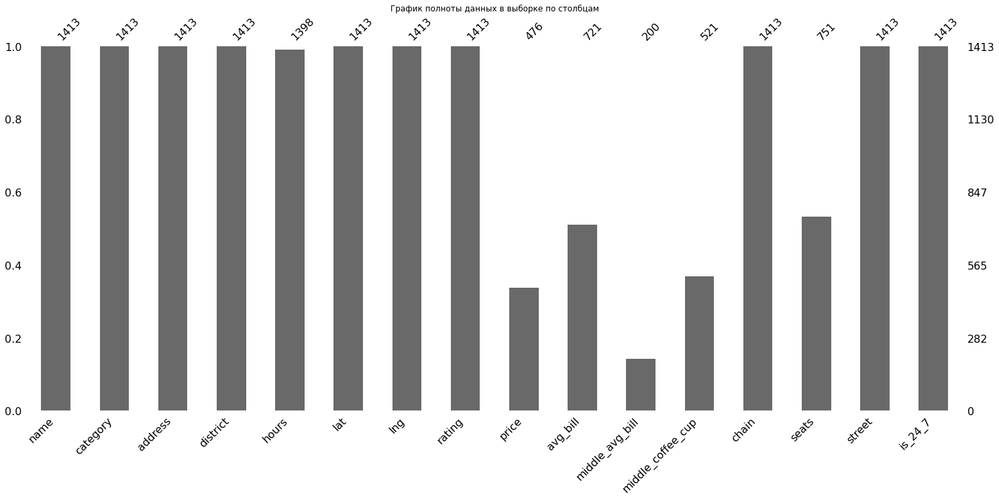

In [50]:
#создаем отдельный дф с данными тоолько по кофейням
coffee_cat = places[places['category'] == 'кофейня']

#возвращаем пропуски вместо значений индикаторов 
coffee_cat[coffee_cat.select_dtypes(include='object').columns] = \
coffee_cat.select_dtypes(include='object').replace('nd', np.nan)

coffee_cat[coffee_cat.select_dtypes(include=[np.number]).columns] = \
coffee_cat.select_dtypes(include=[np.number]).replace(-1, np.nan)

# Проверяем количество пропусков
msno.bar(coffee_cat)
plt.title('График полноты данных в выборке по столбцам')
plt.show()

Всего 1413 записей, сколько и должно быть по количеству кофеен. 
Ситуация по пропускам аналогична генеральной совокупности - справочные данные малочисленны. 

In [51]:
#вернем индикаторы 
coffee_cat[coffee_cat.select_dtypes(include='object').columns] = \
coffee_cat.select_dtypes(include='object').replace(np.nan, 'nd')

coffee_cat[coffee_cat.select_dtypes(include=[np.number]).columns] = \
coffee_cat.select_dtypes(include=[np.number]).replace(np.nan, -1)

coffee_cat.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1413 entries, 3 to 8397
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               1413 non-null   object 
 1   category           1413 non-null   object 
 2   address            1413 non-null   object 
 3   district           1413 non-null   object 
 4   hours              1413 non-null   object 
 5   lat                1413 non-null   float64
 6   lng                1413 non-null   float64
 7   rating             1413 non-null   float64
 8   price              1413 non-null   object 
 9   avg_bill           1413 non-null   object 
 10  middle_avg_bill    1413 non-null   float64
 11  middle_coffee_cup  1413 non-null   float64
 12  chain              1413 non-null   int64  
 13  seats              1413 non-null   float64
 14  street             1413 non-null   object 
 15  is_24_7            1413 non-null   bool   
dtypes: bool(1), float64(6), 

<a id='Анализ-кофеен-по-районам'></a>
Вычислим сколько всего кофеен в датасете, в каких районах их больше всего и каковы особенности их расположения:

In [52]:
#сначала сформируем таблицу 
places_coffee_per_district = places[places['category'] == 'кофейня'].groupby('district')['name'].count()\
.reset_index().sort_values('name', ascending = False)
places_coffee_per_district.columns = ['district', 'count']
print('Всего кофеен:', places_coffee_per_district['count'].sum())
places_coffee_per_district['short_district'] = places_coffee_per_district['district'].apply(create_abbreviation)
places_coffee_per_district

Всего кофеен: 1413


,district,count,short_district
5,Центральный административный округ,428,ЦАО
2,Северный административный округ,193,САО
3,Северо-Восточный административный округ,159,СВАО
1,Западный административный округ,150,ЗАО
8,Южный административный округ,131,ЮАО
0,Восточный административный округ,105,ВАО
7,Юго-Западный административный округ,96,ЮЗАО
6,Юго-Восточный административный округ,89,ЮВАО
4,Северо-Западный административный округ,62,СЗАО


In [53]:
#строим визуализацию распределения
fig = px.bar(places_coffee_per_district, x='short_district', y='count', text='count', 
             title='Количество кофеен по районам')
fig.update_layout(xaxis_title='Названия районов', yaxis_title='Количество кофеен', 
                  xaxis={'categoryorder':'total descending'})
fig.show()

Ожидаемо, большинство кофеен в Центральном административном округе. 

Представим распределение кофеен на карте для наглядности: 

In [54]:
# создаём карту Москвы
m3 = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=places_coffee_per_district,
    columns=['district', 'count'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Количество кофеен по районам',
).add_to(m3)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m3)

# применяем функцию create_clusters() к каждой строке датафрейма
places[places['category'] == 'кофейня'].apply(create_clusters, axis=1)

# выводим карту
m3

Таким образом, высокая концентрация кофеен в центре, средняя на севере города, а также в западном и южном административных округах. В остальных районах количество кофеен заметно ниже. 

<a id='Круглосуточные-кофейни'></a>
Посмотрим, есть ли среди них круглосуточные кофейни:

In [55]:
#сначала сформируем таблицу 
places_coffee_24_7 = places[(places['category'] == 'кофейня') & (places['is_24_7'] == True)].groupby('district')['name'].count()\
.reset_index().sort_values('name', ascending = False)
places_coffee_24_7.columns = ['district', 'count']
places_coffee_24_7['short_district'] = places_coffee_24_7['district'].apply(create_abbreviation)
print('Всего круглосуточных кофеен:', places_coffee_24_7['count'].sum())
places_coffee_24_7

Всего круглосуточных кофеен: 59


,district,count,short_district
5,Центральный административный округ,26,ЦАО
1,Западный административный округ,9,ЗАО
7,Юго-Западный административный округ,7,ЮЗАО
0,Восточный административный округ,5,ВАО
2,Северный административный округ,5,САО
3,Северо-Восточный административный округ,3,СВАО
4,Северо-Западный административный округ,2,СЗАО
6,Юго-Восточный административный округ,1,ЮВАО
8,Южный административный округ,1,ЮАО


Без графика распределения видна разница в районах по этому показателю. 

Для наглядности нанесем результат на карту:

In [56]:
# создаём карту Москвы
m4 = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=places_coffee_24_7,
    columns=['district', 'count'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Количество круглосуточных кофеен по районам',
).add_to(m4)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m4)

# применяем функцию create_clusters() к каждой строке датафрейма
places[(places['category'] == 'кофейня') & (places['is_24_7'] == True)].apply(create_clusters, axis=1)

# выводим карту
m4

Больше всего круглосуточных кофеен в центре, затем идет запад и юго-запад, в остальных районах подобных заведений 5 и менее. 

<a id='Рейтинг-кофеен-по-районам'></a>
Внимательнее посмотрим на распределение среднего рейтинга кофеен по районам:

In [57]:
#сначала сформируем таблицу 
coffee_rating_per_district = places[(places['category'] == 'кофейня')].groupby('district')['rating'].mean()\
.reset_index().sort_values('rating', ascending = False)
coffee_rating_per_district.columns = ['district', 'mean_rating']
coffee_rating_per_district['mean_rating'] = round(coffee_rating_per_district['mean_rating'], 2)
coffee_rating_per_district['short_district'] = coffee_rating_per_district['district'].apply(create_abbreviation)
coffee_rating_per_district

,district,mean_rating,short_district
5,Центральный административный округ,4.34,ЦАО
4,Северо-Западный административный округ,4.33,СЗАО
2,Северный административный округ,4.29,САО
7,Юго-Западный административный округ,4.28,ЮЗАО
0,Восточный административный округ,4.28,ВАО
8,Южный административный округ,4.23,ЮАО
6,Юго-Восточный административный округ,4.23,ЮВАО
3,Северо-Восточный административный округ,4.22,СВАО
1,Западный административный округ,4.20,ЗАО


In [58]:
fig = px.bar(coffee_rating_per_district, x='short_district', y='mean_rating', text='mean_rating',
             title='Распределение среднего рейтингов кофеен по районам')
fig.update_layout(xaxis_title='Названия районов', yaxis_title='Среднее рейтинга по кофейням', yaxis=dict(range=[4.1, 4.4]))
fig.show()

Рейтинг по районам кардинально не отличается: у кофеен в центре, которые по рейтингу на первом месте, средний рейтинг составляет 4,34, а у кофеен с последнего места по рейтингу - запада города, средний рейтинг составляет 4,20. Разница в 14 сотых. 

<a id='Стоимость-капучино'></a>
Определим, на какую стоимость чашки капучино стоит ориентироваться при открытии.

Для этого найдем среднее значение цены чашки капучино во всех категориях заведений из датасета по районам: 

In [59]:
coffee_price_per_district = places[places['middle_coffee_cup'] != -1].groupby('district')['middle_coffee_cup'].mean()\
.reset_index().sort_values('middle_coffee_cup', ascending = False)
coffee_price_per_district.columns = ['district', 'mean_coffee_price']
coffee_price_per_district['mean_coffee_price'] = round(coffee_price_per_district['mean_coffee_price'], 2)
coffee_price_per_district['short_district'] = coffee_price_per_district['district'].apply(create_abbreviation)
coffee_price_per_district

,district,mean_coffee_price,short_district
1,Западный административный округ,189.64,ЗАО
5,Центральный административный округ,188.21,ЦАО
7,Юго-Западный административный округ,183.49,ЮЗАО
0,Восточный административный округ,174.02,ВАО
3,Северо-Восточный административный округ,165.33,СВАО
2,Северный административный округ,165.09,САО
4,Северо-Западный административный округ,160.46,СЗАО
8,Южный административный округ,157.83,ЮАО
6,Юго-Восточный административный округ,150.77,ЮВАО


In [60]:
fig = px.bar(coffee_price_per_district, x='short_district', y='mean_coffee_price', text='mean_coffee_price',
             title='Распределение средней цены за чашку кофе по районам')
fig.update_layout(xaxis_title='Названия районов', yaxis_title='Средняя цена за чашку кофе')
fig.show()

Удивительно, но самая высокая в среднем цена за чашку капучино не в центральном районе (188.21), а западном (189.64).

Посмотрим на среднюю стоимость среди кофеен:

In [61]:
coffee_price_per_district_2 = places[(places['middle_coffee_cup'] != -1) & (places['category'] == 'кофейня')]\
.groupby('district')['middle_coffee_cup'].mean()\
.reset_index().sort_values('middle_coffee_cup', ascending = False)
coffee_price_per_district_2.columns = ['district', 'mean_coffee_price']
coffee_price_per_district_2['mean_coffee_price'] = round(coffee_price_per_district_2['mean_coffee_price'], 2)
coffee_price_per_district_2['short_district'] = coffee_price_per_district_2['district'].apply(create_abbreviation)

fig = px.bar(coffee_price_per_district_2, x='short_district', y='mean_coffee_price', text='mean_coffee_price',
             title='Распределение средней цены за чашку кофе среди кофеен по районам')
fig.update_layout(xaxis_title='Названия районов', yaxis_title='Средняя цена за чашку кофе')
fig.show()

Ситуация кардинально не изменилась, за исключением СЗАО - средняя цена выросла на 5. 

Ситуация с ЗАО и ЦАО напоминает нам о пропусках, которые мы обнаружили при обзоре данных - выводы по данным о цене для нас не являются репрезентативными в данном случае. 

Однако, если все же опираться на полученные результаты, то имеет смысл не превышать среднюю цену в том районе, который будет выбран для открытия кофейни. 

<a id='Рекомендация'></a>
Судя по выводам, наиболее благоприятный район для открытия - Восточный. 

Соберем по нему более конкретную информацию: 

In [62]:
east_places = places[places['district'] == 'Восточный административный округ']
east_category_count = east_places.groupby('category')['name'].count()\
.reset_index().sort_values('name', ascending = False)
east_category_count.columns = ['category', 'count']
print('Всего заведений общепита:', east_category_count['count'].sum())
east_category_count

Всего заведений общепита: 798


,category,count
3,кафе,272
6,ресторан,160
4,кофейня,105
5,пиццерия,72
2,быстрое питание,71
0,"бар,паб",53
7,столовая,40
1,булочная,25


Категория кофеен занимает 3 место по количеству, еще раз посмотрим на расположение точек общепита и попытаемся найти наилучшее место для открытия новой:

In [63]:
# создаём карту Москвы
m5 = Map(location=[55.789934, 37.667498], zoom_start=16, tiles='Cartodb Positron')

#выделим районы и границы
GeoJson(
    state_geo,
    style_function=lambda feature: {'fillColor': '#ffaf00', 'color': 'black', 'weight': 1, 'fillOpacity': 0.5}
).add_to(m5)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m5)

# применяем функцию create_clusters() к каждой строке датафрейма
places[(places['district'] == 'Центральный административный округ')\
       | (places['district'] == 'Восточный административный округ')]\
.apply(create_clusters, axis=1)

# выводим карту
m5

Судя по карте, наилучшим местом будет пересечение улицы Жебрунова и Матросской Тишины/пересечение улицы Матросской Тишины и улицы Гастелло - поблизости нет заведений общепита как в Восточном, так и Центральном районах, но, так как рядом с этим местом промзона (а вглубь района еще и туберкулезный центр), то имеет смысл перенести заведение севернее - около Микульского переулка.

**Вывод:**

* Всего кофеен в Москве: 1413, высокая концентрация кофеен в центре (428), средняя на севере города (север: 193, северо-восток: 159), а также в западном (150) и южном административных округах(131). В остальных районах количество кофеен заметно ниже (Восточный административный округ: 105, Юго-западный административный округ: 96, Юго-восточный административный округ: 89, Северо-западный административный округ: 62);
* Всего круглосуточных кофеен: 59, больше всего круглосуточных кофеен в центре, затем идет запад и северо-запад, в остальных районах подобных заведений 5 и менее;
* Рейтинг по районам кардинально не отличается: у кофеен в центре, которые по рейтингу на первом месте, средний рейтинг составляет 4,34, а у кофеен с последнего места по рейтингу - запада города, средний рейтинг составляет 4,20.;
* Судя по немногочисленном данным о средней цене за чашку кофе: самая высокая цена в Западном административном округе (189), самая низкая в Юго-Восточном административном округе (150) - значения из данных по всем категориям, данные из выборки по кофейням не имеют значительных отличий за исключением СЗАО, где средняя цена поднялась на 5.

Исходя из результатов анализа, рекомендуемый район для открытия кофейни - Восточный административный округ:
* Район с низкой плотностью кофеен (105) - низкая конкуренция в абсолютном выражении;
* Небольшое количество кофеен с круглосуточным режимом работы (5) - возможность удовлетворить спрос в ночное время суток в случае открытия точки ближе к Центральному административному округу; 
* Среднее значение рейтинга кофеен по району (4.28) - отсутствие крайне успешных конкурентов, однако, стоит помнить, что разница рейтинга по районам в целом не сильно разнится;
* Средняя цена за чашку кофе по району (174) - это 4 место по дороговизне из 9 по всем категориям заведений, такая стоимость позволит предложить более демократичную цену покупателям и при этом получать все еще приятную маржу. 
* Можно отметить аналогичную ситуацию с конкуренцией во всех соседних районах (за исключением центрального).

Рекомендуемое место - около Микульского переулка:
* Граница с центром города;
* Отсутствие точек общепита поблизости как в Восточном, так и Центральном районе;
* Баланс жилых домов, коммерции, культурных сооружений и гос. учреждений, отсутствие промышленной зоны. 

[Вернуться к содержанию](#Содержание)

<a id='Общий-вывод'></a>
## Общий вывод

**Исследование данных**:

* Наибольшее количество объектов приходится на кафе (2377) и рестораны (2041), за ними следуют кофейни (1413). В среднюю категорию по количеству входят бары/пабы (765), пиццерии (633) и заведения быстрого питания (603), отстающими являются столовые (315) и булочные (256);
* Больше всего посадочных мест как в абсолютном выражении, так и по медиане (86) - в категории ресторанов, напротив, менее всего мест в категории булочных (медиана: 50);
* Большинство заведений не входит в какую-либо сеть - 62% или 5201 заведение против 38%, 3205 сетевых заведений;
* Категории заведений, которые чаще являются сетевыми, это "булочная": 99 несетевых на 157 сетевых заведений (61%), "кофейня": 693 несетевых на 720 сетевых (51%), "пиццерия": 303 несетевых на 330 сетевых (52%). Остальные категории в основном включают в себя несетевые заведения;
* Наиболее ярко представленная сеть - это "Шоколадница" с 119 точками, относится к категории кофеен, замыкает топ-15 сетей по количеству заведений "Кофемания" с 22 точками, также относится к категории "кофейня". 2 и 3 места заняли сети пиццерий "Домино'с" и "Додо". В топе есть только одна "булочная" сеть - "Буханка" с 25 точками. Доля кофеен в топе составила 40%;
* Всего в наших данных 8406 заведений и 9 районов. Лидером по количеству заведений является Центральный административный округ с 2242 заведениями, меньше всего точек в Северо-западном административном округе - 409.
* Среднее рейтинга по категориям распределена равномерно: все значения в пределах 2х десятых пункта от 4.1. Минимальный рейтинг у заведений категории "быстрое питание" - 4.05, максимальный у баров и пабов - 4.39;
* Наивысшие оценки заведений в центре города, чуть ниже на Северо-западе. Самые низкие оценки - на Юго-востоке;
* На проспекте Мира наибольшее количество заведений - 183, из которых 53 кафе, 44 ресторана, 36 кофеен, затем уже остальные категории. По количеству кафе за проспектом Мира следует МКАД, где 45 кафе, по количеству ресторанов второе место делят проспект Вернадского и Ленинградский проспект. Замыкает топ Пятницкая улица с 48 заведениями, из которых 18 ресторанов и 7 кафе в том числе. Выявлена прямая положительная корреляция между протяженностью улицы и количеством заведений;
* Всего 458 улиц с 1 заведением. Только 29% из них относится к сетям, большинство таких заведений является кафе - 160, и только 8 булочных. Средняя оценка этих заведений составляет 4.2. Распределены по всему городу;
* Заведения с наивысшим средним чеком располагаются в центре и тянутся в сторону запада (Западный административный округ и Центральный административный округ), наименьший средний чек на юго-востоке и севере города (Юго-Восточный административный округ, Южный административный округ, Северо-Восточный административный округ).

**Детализация исследования: открытие кофейни**:

* Всего кофеен в Москве: 1413, высокая концентрация кофеен в центре (428), средняя на севере города (север: 193, северо-восток: 159), а также в западном (150) и южном административных округах(131). В остальных районах количество кофеен заметно ниже (Восточный административный округ: 105, Юго-западный административный округ: 96, Юго-восточный административный округ: 89, Северо-западный административный округ: 62);
* Всего круглосуточных кофеен: 59, больше всего круглосуточных кофеен в центре, затем идет запад и северо-запад, в остальных районах подобных заведений 5 и менее;
* Рейтинг по районам кардинально не отличается: у кофеен в центре, которые по рейтингу на первом месте, средний рейтинг составляет 4,34, а у кофеен с последнего места по рейтингу - запада города, средний рейтинг составляет 4,20.;
* Судя по немногочисленном данным о средней цене за чашку кофе: самая высокая цена в Западном административном округе (189), самая низкая в Юго-Восточном административном округе (150) - значения из данных по всем категориям, данные из выборки по кофейням не имеют значительных отличий за исключением СЗАО, где средняя цена поднялась на 5.

Исходя из результатов анализа, рекомендуемый район для открытия кофейни - Восточный административный округ:
* Район с низкой плотностью кофеен (105) - низкая конкуренция в абсолютном выражении;
* Небольшое количество кофеен с круглосуточным режимом работы (5) - возможность удовлетворить спрос в ночное время суток в случае открытия точки ближе к Центральному административному округу; 
* Среднее значение рейтинга кофеен по району (4.28) - отсутствие крайне успешных конкурентов, однако, стоит помнить, что разница рейтинга по районам в целом не сильно разнится;
* Средняя цена за чашку кофе по району (174) - это 4 место по дороговизне из 9 по всем категориям заведений, такая стоимость позволит предложить более демократичную цену покупателям и при этом получать все еще приятную маржу. 
* Можно отметить аналогичную ситуацию с конкуренцией во всех соседних районах (за исключением центрального).

Рекомендуемое место - около Микульского переулка:
* Граница с центром города;
* Отсутствие точек общепита поблизости как в Восточном, так и Центральном районе;
* Баланс жилых домов, коммерции, культурных сооружений и гос. учреждений, отсутствие промышленной зоны.

<a id='Подготовка-презентации'></a>
## Подготовка презентации

Презентация: https://disk.yandex.ru/i/esGL7qOYlnEEgg